In [1]:
reset -fs

In [2]:
import pandas as pd
import random
import time, os
import re
import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import median_absolute_error as medae
from sklearn.preprocessing import StandardScaler

from datetime import datetime as dt


## Import raw MADIS station data

In [3]:
raw_stations = pd.read_csv('madis_scrape_04-07-2021.csv', header=0, na_values=-99999.0, parse_dates=[['OBDATE', 'OBTIME']], keep_date_col=True)
raw_stations.shape

(96078, 31)

In [4]:
raw_stations.head()

,OBDATE_OBTIME,STAID,OBDATE,OBTIME,PVDR,SUBPVDR,TD,D,RH,D.1,...,D.7,LAT,D.8,LON,D.9,PCP1H,D.10,PCP24H,D.11,Unnamed: 29
0,2021-04-07 00:55:00,KO22,04/07/2021,00:55,OTHER-MTR,NaN,280.149994,V,40.287102,V,...,Z,38.029999,Z,-120.419998,Z,NaN,Z,NaN,Z,NaN
1,2021-04-07 00:58:00,KDMA,04/07/2021,00:58,OTHER-MTR,NaN,266.549988,V,9.938391,V,...,Z,32.169998,Z,-110.879997,Z,NaN,Z,NaN,Z,NaN
2,2021-04-07 00:55:00,KL18,04/07/2021,00:55,OTHER-MTR,NaN,284.149994,V,59.735806,V,...,Z,33.349998,Z,-117.250000,Z,NaN,Z,NaN,Z,NaN
3,2021-04-07 00:55:00,KMHR,04/07/2021,00:55,OTHER-MTR,NaN,279.149994,V,31.335583,V,...,Z,38.540001,Z,-121.300003,Z,NaN,Z,NaN,Z,NaN
4,2021-04-07 00:55:00,KBDN,04/07/2021,00:55,OTHER-MTR,NaN,262.149994,V,11.336117,V,...,Z,44.090000,Z,-121.199997,Z,NaN,Z,NaN,Z,NaN


In [5]:
# rename the datetime column
raw_stations.rename(columns={'OBDATE_OBTIME': 'OBSERVATION'}, inplace=True)

In [6]:
# parse QC flags by looking at rows with X (rejected), Q (questioned), B (subjective bad) values in D-D.11
flagged = raw_stations.isin(['X', 'Q', 'B']).any()
flagged

OBSERVATION    False
STAID          False
OBDATE         False
OBTIME         False
PVDR           False
SUBPVDR        False
TD             False
D              False
RH             False
D.1            False
ALTSE          False
D.2            False
SLP            False
D.3            False
P              False
D.4            False
T              False
D.5            False
FF             False
D.6            False
ELEV           False
D.7            False
LAT            False
D.8            False
LON            False
D.9            False
PCP1H          False
D.10           False
PCP24H         False
D.11           False
Unnamed: 29    False
dtype: bool

Great, no flagged data! Now I focus on data columns of possible interest (label, description, units):
- __STAID :__ Station ID
- __T :__ Temperature (Kelvin)
- __TD :__ Dewpoint temperature (Kelvin) 
- __RH :__ Relative humidity (percent)
- __P :__ Station pressure (Pascal)
- __FF :__ Wind speed (meters/second)
- __PCP1H :__ Accumulated precipitation over one hour (meters)
- __PCP24H :__ Accumulated precipitation over 24 hours (meters)
- __LAT, LON :__ Latitude and Longitude
- __ELEV :__ Station elevation (meters)
- __OBSERVATION, OBDATE, OBTIME :__ Time labels for possible aggregation (UTC)

In [7]:
stations_hourly = raw_stations[['STAID', 'T', 'TD', 'RH', 'P', 'FF', 'PCP1H', 'PCP24H', 'LAT', 'LON', 'ELEV', 'OBSERVATION', 'OBDATE', 'OBTIME']].copy()
stations_hourly.head()

,STAID,T,TD,RH,P,FF,PCP1H,PCP24H,LAT,LON,ELEV,OBSERVATION,OBDATE,OBTIME
0,KO22,294.149994,280.149994,40.287102,94118.710938,1.5,NaN,NaN,38.029999,-120.419998,646.0,2021-04-07 00:55:00,04/07/2021,00:55
1,KDMA,301.049988,266.549988,9.938391,91651.625000,5.7,NaN,NaN,32.169998,-110.879997,824.0,2021-04-07 00:58:00,04/07/2021,00:58
2,KL18,292.149994,284.149994,59.735806,98978.203125,2.6,NaN,NaN,33.349998,-117.250000,216.0,2021-04-07 00:55:00,04/07/2021,00:55
3,KMHR,297.149994,279.149994,31.335583,101141.781250,3.1,NaN,NaN,38.540001,-121.300003,29.0,2021-04-07 00:55:00,04/07/2021,00:55
4,KBDN,293.149994,262.149994,11.336117,89456.765625,4.1,NaN,NaN,44.090000,-121.199997,1055.0,2021-04-07 00:55:00,04/07/2021,00:55


Since this dataset includes data reported at midnight on 04/08/2021, the `OBDATE` column has two values. I map them to the day before:

In [8]:
stations_hourly['OBDATE'] = stations_hourly['OBDATE'].map({'04/08/2021': '04/07/2021', '04/07/2021': '04/07/2021'})

### Get a daily average value for each variable

In [9]:
# Count how many reports for each station 
obs_by_station = (stations_hourly.groupby('STAID')['OBDATE']
                  .agg(['count']).sort_values((['count']), ascending=False))
obs_by_station

,count
STAID,
KFHR,46
KM19,46
KBCE,46
KBBW,46
KMAE,46
...,...
CWIP,2
KNJW,1
KHKS,1


In [10]:
# # how many stations have less than 12 reports?
# .
# .
# .
# .
# .
# .
# .

In [11]:
daily_avg = stations_hourly.groupby('STAID').mean().reset_index()

avg_names = [(name, 'AVG_'+name) for name in daily_avg.iloc[:, 1:7].columns.values]
daily_avg.rename(columns = dict(avg_names), inplace=True)

daily_avg

,STAID,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,AVG_PCP1H,PCP24H,LAT,LON,ELEV
0,BKPR,272.941661,269.774994,79.625518,94561.501953,2.968182,NaN,NaN,42.570000,21.030001,559.0
1,CAAW,281.316661,278.066661,81.066488,NaN,5.241667,NaN,NaN,44.639999,-63.520000,24.0
2,CABB,281.358327,277.858327,79.799666,NaN,4.950000,NaN,NaN,44.709999,-63.630001,4.0
3,CABF,281.483327,279.066661,85.087293,NaN,8.833333,NaN,NaN,47.619999,-57.619999,11.0
4,CABR,281.108327,277.816661,80.857188,NaN,3.691667,NaN,NaN,44.750000,-63.660000,10.0
...,...,...,...,...,...,...,...,...,...,...,...
3296,UKLL,273.774994,269.941661,77.146355,96979.407552,3.714286,NaN,NaN,49.820000,23.950001,319.0
3297,UKLU,276.233327,268.483327,60.654222,99438.359375,2.000000,NaN,NaN,48.630001,22.250000,117.0
3298,UMBB,275.733327,270.066661,69.349916,98720.255859,4.583333,NaN,NaN,52.119999,23.900000,143.0
3299,UMKK,276.024994,272.649994,79.770707,99988.595052,5.666667,NaN,NaN,54.880001,20.600000,21.0


### Computing values

I want to get a sense of which variables are most complete in this dataset - I will eliminate variables if there's only a few hundred reported values for it, for example. 

In [12]:
daily_avg_exists = daily_avg.notna().sum()
daily_avg_exists

STAID        3301
AVG_T        3267
AVG_TD       3249
AVG_RH       3246
AVG_P        2806
AVG_FF       3263
AVG_PCP1H    1199
PCP24H        220
LAT          3301
LON          3301
ELEV         3301
dtype: int64

The `AVG_PCP1H`, `AVG_PCP24H` counts are a bit concerning. According to MADIS the `PCP1H` values are often  reported as blank when there is no rain, so I will assume any NaN values in `PCP1H` are equal to zero.  

In [13]:
# restrict grouped df to stations that reported at least one hourly precitation value
rain_stations = stations_hourly[stations_hourly.groupby(['STAID','PCP1H'])['PCP1H'].transform('count') > 1]
rain_stations = rain_stations.groupby('STAID').mean().reset_index()
rain_stations

,STAID,T,TD,RH,P,FF,PCP1H,PCP24H,LAT,LON,ELEV
0,CWCJ,280.875000,280.349998,96.477453,NaN,3.350000,0.001300,NaN,48.599998,-86.300003,206.0
1,CWDO,274.250000,274.110004,98.998349,NaN,7.700000,0.000920,NaN,49.680000,-54.799999,92.0
2,CWDV,279.090008,277.790002,91.400442,NaN,2.800000,0.000380,NaN,49.029999,-90.470001,489.0
3,CWEZ,280.550003,278.399994,86.266815,NaN,8.800000,0.000300,NaN,48.779999,-123.050003,7.0
4,CWIS,277.100006,276.900009,98.614769,NaN,4.100000,0.000500,NaN,47.279999,-70.629997,719.0
...,...,...,...,...,...,...,...,...,...,...,...
1031,KYIP,292.513630,282.604539,55.452617,98750.464844,2.408535,0.000000,NaN,42.230000,-83.529999,218.0
1032,KYKM,281.102375,270.513630,50.342943,97630.412287,2.151313,0.000000,NaN,46.570000,-120.529999,322.0
1033,KYKN,281.301721,279.687927,90.062449,95758.619612,7.563248,0.000083,0.0079,42.919998,-97.379997,398.0
1034,KYNG,293.261105,280.559085,46.052264,97255.599787,2.408535,0.000000,NaN,41.270000,-80.669998,361.0


It looks like `PCP24H` is not reported by every station. I will have to calculate total daily precipitation from the `PCP1H` values. 

In [14]:
daily_avg.drop(columns=['AVG_PCP1H','PCP24H'], inplace=True)

daily_sum = stations_hourly.groupby('STAID').sum().reset_index()
total_pcp = daily_sum[['STAID','PCP1H']]
total_pcp = total_pcp.rename(columns={'PCP1H': 'TOTAL_PCP'})

daily_avg['TOTAL_PCP'] = total_pcp['TOTAL_PCP']
daily_avg

,STAID,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,LAT,LON,ELEV,TOTAL_PCP
0,BKPR,272.941661,269.774994,79.625518,94561.501953,2.968182,42.570000,21.030001,559.0,0.0
1,CAAW,281.316661,278.066661,81.066488,NaN,5.241667,44.639999,-63.520000,24.0,0.0
2,CABB,281.358327,277.858327,79.799666,NaN,4.950000,44.709999,-63.630001,4.0,0.0
3,CABF,281.483327,279.066661,85.087293,NaN,8.833333,47.619999,-57.619999,11.0,0.0
4,CABR,281.108327,277.816661,80.857188,NaN,3.691667,44.750000,-63.660000,10.0,0.0
...,...,...,...,...,...,...,...,...,...,...
3296,UKLL,273.774994,269.941661,77.146355,96979.407552,3.714286,49.820000,23.950001,319.0,0.0
3297,UKLU,276.233327,268.483327,60.654222,99438.359375,2.000000,48.630001,22.250000,117.0,0.0
3298,UMBB,275.733327,270.066661,69.349916,98720.255859,4.583333,52.119999,23.900000,143.0,0.0
3299,UMKK,276.024994,272.649994,79.770707,99988.595052,5.666667,54.880001,20.600000,21.0,0.0


In [15]:
# add minimum reported values to the dataset
daily_min = stations_hourly.groupby('STAID').min().reset_index()
min_td = daily_min[['STAID','TD']]
min_t = daily_min[['STAID','T']]
min_p = daily_min[['STAID','P']]
daily_avg['MIN_TD'] = min_td['TD']
daily_avg['MIN_T'] = min_t['T']
daily_avg['MIN_P'] = min_p['P']
daily_avg

,STAID,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,LAT,LON,ELEV,TOTAL_PCP,MIN_TD,MIN_T,MIN_P
0,BKPR,272.941661,269.774994,79.625518,94561.501953,2.968182,42.570000,21.030001,559.0,0.0,268.149994,271.149994,93847.031250
1,CAAW,281.316661,278.066661,81.066488,NaN,5.241667,44.639999,-63.520000,24.0,0.0,276.149994,278.149994,NaN
2,CABB,281.358327,277.858327,79.799666,NaN,4.950000,44.709999,-63.630001,4.0,0.0,277.149994,278.149994,NaN
3,CABF,281.483327,279.066661,85.087293,NaN,8.833333,47.619999,-57.619999,11.0,0.0,277.149994,278.149994,NaN
4,CABR,281.108327,277.816661,80.857188,NaN,3.691667,44.750000,-63.660000,10.0,0.0,277.149994,278.149994,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3296,UKLL,273.774994,269.941661,77.146355,96979.407552,3.714286,49.820000,23.950001,319.0,0.0,268.149994,270.149994,96587.484375
3297,UKLU,276.233327,268.483327,60.654222,99438.359375,2.000000,48.630001,22.250000,117.0,0.0,266.149994,268.149994,99240.585938
3298,UMBB,275.733327,270.066661,69.349916,98720.255859,4.583333,52.119999,23.900000,143.0,0.0,267.149994,271.149994,98539.437500
3299,UMKK,276.024994,272.649994,79.770707,99988.595052,5.666667,54.880001,20.600000,21.0,0.0,270.149994,272.149994,99680.875000


In [16]:
# add maximum reported values to the dataset
daily_max = stations_hourly.groupby('STAID').max().reset_index()
max_td = daily_max[['STAID','TD']]
max_t = daily_max[['STAID','T']]
max_p = daily_max[['STAID','P']]
daily_avg['MAX_TD'] = max_td['TD']
daily_avg['MAX_T'] = max_t['T']
daily_avg['MAX_P'] = max_p['P']
daily_avg

,STAID,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,LAT,LON,ELEV,TOTAL_PCP,MIN_TD,MIN_T,MIN_P,MAX_TD,MAX_T,MAX_P
0,BKPR,272.941661,269.774994,79.625518,94561.501953,2.968182,42.570000,21.030001,559.0,0.0,268.149994,271.149994,93847.031250,271.149994,274.149994,95173.375000
1,CAAW,281.316661,278.066661,81.066488,NaN,5.241667,44.639999,-63.520000,24.0,0.0,276.149994,278.149994,NaN,280.149994,287.149994,NaN
2,CABB,281.358327,277.858327,79.799666,NaN,4.950000,44.709999,-63.630001,4.0,0.0,277.149994,278.149994,NaN,279.149994,287.149994,NaN
3,CABF,281.483327,279.066661,85.087293,NaN,8.833333,47.619999,-57.619999,11.0,0.0,277.149994,278.149994,NaN,282.149994,286.149994,NaN
4,CABR,281.108327,277.816661,80.857188,NaN,3.691667,44.750000,-63.660000,10.0,0.0,277.149994,278.149994,NaN,279.149994,287.149994,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3296,UKLL,273.774994,269.941661,77.146355,96979.407552,3.714286,49.820000,23.950001,319.0,0.0,268.149994,270.149994,96587.484375,272.149994,278.149994,97460.210938
3297,UKLU,276.233327,268.483327,60.654222,99438.359375,2.000000,48.630001,22.250000,117.0,0.0,266.149994,268.149994,99240.585938,270.149994,280.149994,99636.132812
3298,UMBB,275.733327,270.066661,69.349916,98720.255859,4.583333,52.119999,23.900000,143.0,0.0,267.149994,271.149994,98539.437500,273.149994,279.149994,98835.335938
3299,UMKK,276.024994,272.649994,79.770707,99988.595052,5.666667,54.880001,20.600000,21.0,0.0,270.149994,272.149994,99680.875000,274.149994,280.149994,100179.882812


## Read MODIS Aqua Cloud Fraction for each location
The MODIS Cloud Fraction computation  on April 8, 2021 is the target variable.

Note: 'Aqua' refers to the instrument platform - there are two satellites with the MODIS instrument, and the Aqua instrument recorded a much more complete cloud fraction dataset over the US on April 8, 2021. 

In [17]:
# This is to correct for floating point errors in the MODIS Latitude and Longitude indices 
def round_coords(arr, d=2):
        vals = map(str, [round(float(val), d) for val in arr])
        return vals

# This is to be able to map station lat/lon to MODIS lat/lon. A little hacky, 
# will work out a better solution in the future. 
def adjust (x):
    x = x.replace(x[-1:], '5')
    return x

In [18]:
# Station lat/lon hack:

daily_avg['LAT'] = daily_avg['LAT'].apply(lambda x: '{:.2f}'.format(x))
daily_avg['LON'] = daily_avg['LON'].apply(lambda x: '{:.2f}'.format(x)) 

daily_avg['LAT'] = daily_avg['LAT'].apply(lambda x: adjust(x))
daily_avg['LON'] = daily_avg['LON'].apply(lambda x: adjust(x))                                     

adj_station_daily = daily_avg
adj_station_daily

,STAID,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,LAT,LON,ELEV,TOTAL_PCP,MIN_TD,MIN_T,MIN_P,MAX_TD,MAX_T,MAX_P
0,BKPR,272.941661,269.774994,79.625518,94561.501953,2.968182,42.55,21.05,559.0,0.0,268.149994,271.149994,93847.031250,271.149994,274.149994,95173.375000
1,CAAW,281.316661,278.066661,81.066488,NaN,5.241667,55.65,-63.55,24.0,0.0,276.149994,278.149994,NaN,280.149994,287.149994,NaN
2,CABB,281.358327,277.858327,79.799666,NaN,4.950000,44.75,-65.65,4.0,0.0,277.149994,278.149994,NaN,279.149994,287.149994,NaN
3,CABF,281.483327,279.066661,85.087293,NaN,8.833333,47.65,-57.65,11.0,0.0,277.149994,278.149994,NaN,282.149994,286.149994,NaN
4,CABR,281.108327,277.816661,80.857188,NaN,3.691667,44.75,-53.55,10.0,0.0,277.149994,278.149994,NaN,279.149994,287.149994,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3296,UKLL,273.774994,269.941661,77.146355,96979.407552,3.714286,49.85,23.95,319.0,0.0,268.149994,270.149994,96587.484375,272.149994,278.149994,97460.210938
3297,UKLU,276.233327,268.483327,60.654222,99438.359375,2.000000,48.65,22.25,117.0,0.0,266.149994,268.149994,99240.585938,270.149994,280.149994,99636.132812
3298,UMBB,275.733327,270.066661,69.349916,98720.255859,4.583333,55.15,23.95,143.0,0.0,267.149994,271.149994,98539.437500,273.149994,279.149994,98835.335938
3299,UMKK,276.024994,272.649994,79.770707,99988.595052,5.666667,54.55,25.65,21.0,0.0,270.149994,272.149994,99680.875000,274.149994,280.149994,100179.882812


In [19]:
station_lat = adj_station_daily['LAT'].tolist()
station_lon = adj_station_daily['LON'].tolist()

In [20]:
cloudfr_df = pd.read_csv('test_modis/MYDAL2_D_CLD_FR_2021-04-08_rgb_3600x1800.SS.CSV', header=0, index_col=0, na_values=99999.0)
cloudfr_df = cloudfr_df.round(2)
cloudfr_df.columns = round_coords(cloudfr_df.columns, 2)
cloudfr_df.index = round_coords(cloudfr_df.index, 2)
cloudfr_values = cloudfr_df.lookup(station_lat, station_lon)
cloudfr_values

/var/folders/_g/0w700wks7s1f9mzvhbcn7vvc0000gn/T/ipykernel_37784/421724439.py:5: FutureWarning: The 'lookup' method is deprecated and will beremoved in a future version.You can use DataFrame.melt and DataFrame.locas a substitute.
  cloudfr_values = cloudfr_df.lookup(station_lat, station_lon)


KeyError: 'One or more column labels was not found'

### Cleaning up station longitudes
Column labels in the MODIS data are longitude values. 

In [21]:
# Look for out of bounds values
low_lon = adj_station_daily['LON'][adj_station_daily['LON'].astype(float) < -180]
high_lon = adj_station_daily['LON'][adj_station_daily['LON'].astype(float) > 180]

print(low_lon)
print(high_lon)

39      -553.25
49      -552.55
328     -550.75
365     -555.75
406     -520.55
438     -508.55
477     -522.55
502     -506.75
503     -550.75
511     -554.05
811     -502.45
830     -505.05
905     -500.55
916     -524.55
1057    -555.25
1058    -558.45
1068    -553.05
1076    -556.95
1077    -559.55
1331    -525.45
1378    -557.45
1424    -502.05
1613    -500.05
1651    -508.05
1664    -556.55
1680    -505.95
1712    -504.75
1714    -505.55
1724    -552.75
1858    -502.55
1939    -509.35
1966    -505.85
2067    -507.95
2069    -520.05
2081    -520.55
2147    -553.05
2343    -522.95
2371    -556.05
2420    -509.85
2530    -556.95
2565    -555.85
2758    -523.85
2780    -522.45
Name: LON, dtype: object
Series([], Name: LON, dtype: object)


In [22]:
# Get names of indexes for which longitude is out of bounds
index_names = adj_station_daily[adj_station_daily['LON'].astype(float) < -180].index

# Delete these row indexes 
adj_station_daily.drop(index_names , inplace=True)
features = adj_station_daily
features

,STAID,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,LAT,LON,ELEV,TOTAL_PCP,MIN_TD,MIN_T,MIN_P,MAX_TD,MAX_T,MAX_P
0,BKPR,272.941661,269.774994,79.625518,94561.501953,2.968182,42.55,21.05,559.0,0.0,268.149994,271.149994,93847.031250,271.149994,274.149994,95173.375000
1,CAAW,281.316661,278.066661,81.066488,NaN,5.241667,55.65,-63.55,24.0,0.0,276.149994,278.149994,NaN,280.149994,287.149994,NaN
2,CABB,281.358327,277.858327,79.799666,NaN,4.950000,44.75,-65.65,4.0,0.0,277.149994,278.149994,NaN,279.149994,287.149994,NaN
3,CABF,281.483327,279.066661,85.087293,NaN,8.833333,47.65,-57.65,11.0,0.0,277.149994,278.149994,NaN,282.149994,286.149994,NaN
4,CABR,281.108327,277.816661,80.857188,NaN,3.691667,44.75,-53.55,10.0,0.0,277.149994,278.149994,NaN,279.149994,287.149994,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3296,UKLL,273.774994,269.941661,77.146355,96979.407552,3.714286,49.85,23.95,319.0,0.0,268.149994,270.149994,96587.484375,272.149994,278.149994,97460.210938
3297,UKLU,276.233327,268.483327,60.654222,99438.359375,2.000000,48.65,22.25,117.0,0.0,266.149994,268.149994,99240.585938,270.149994,280.149994,99636.132812
3298,UMBB,275.733327,270.066661,69.349916,98720.255859,4.583333,55.15,23.95,143.0,0.0,267.149994,271.149994,98539.437500,273.149994,279.149994,98835.335938
3299,UMKK,276.024994,272.649994,79.770707,99988.595052,5.666667,54.55,25.65,21.0,0.0,270.149994,272.149994,99680.875000,274.149994,280.149994,100179.882812


In [23]:
station_lat = features['LAT'].tolist()
station_lon = features['LON'].tolist()

cloudfr_df = pd.read_csv('test_modis/MYDAL2_D_CLD_FR_2021-04-08_rgb_3600x1800.SS.CSV', header=0, index_col=0, na_values=99999.0)
cloudfr_df = cloudfr_df.round(2)
cloudfr_df.columns = round_coords(cloudfr_df.columns, 2)
cloudfr_df.index = round_coords(cloudfr_df.index, 2)
cloudfr_values = cloudfr_df.lookup(station_lat, station_lon)
cloudfr_values

/var/folders/_g/0w700wks7s1f9mzvhbcn7vvc0000gn/T/ipykernel_37784/3682712164.py:8: FutureWarning: The 'lookup' method is deprecated and will beremoved in a future version.You can use DataFrame.melt and DataFrame.locas a substitute.
  cloudfr_values = cloudfr_df.lookup(station_lat, station_lon)


array([0.96, 1.  , 0.47, ..., 0.63, 1.  , 0.89])

In [24]:
features['CLOUDFRAC'] = cloudfr_values
# Split out station data for mapping
station_data = features.dropna().reset_index()

# Name modeling dataset
weather_data = features.dropna().reset_index()
weather_data

,index,STAID,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,LAT,LON,ELEV,TOTAL_PCP,MIN_TD,MIN_T,MIN_P,MAX_TD,MAX_T,MAX_P,CLOUDFRAC
0,0,BKPR,272.941661,269.774994,79.625518,94561.501953,2.968182,42.55,21.05,559.0,0.0,268.149994,271.149994,93847.031250,271.149994,274.149994,95173.375000,0.96
1,96,CWAE,277.226917,274.534609,83.709071,93514.284856,2.227273,50.15,-122.95,657.0,0.0,272.149994,276.149994,93421.890625,275.149994,283.149994,93891.109375,0.86
2,159,CWHN,279.399994,266.358327,40.261461,93353.580078,2.058333,54.95,-109.95,637.0,0.0,264.149994,272.149994,92622.203125,269.149994,287.149994,93703.421875,1.00
3,193,CWLY,283.774994,272.483327,46.031654,98305.737305,7.204545,50.55,-121.55,228.0,0.0,271.149994,282.149994,98142.265625,274.149994,288.149994,98514.023438,1.00
4,248,CWSA,276.899994,276.774994,99.148805,100487.009766,9.600000,45.95,-65.55,5.0,0.0,276.149994,276.149994,100310.421875,277.149994,277.149994,100720.242188,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2707,3296,UKLL,273.774994,269.941661,77.146355,96979.407552,3.714286,49.85,23.95,319.0,0.0,268.149994,270.149994,96587.484375,272.149994,278.149994,97460.210938,1.00
2708,3297,UKLU,276.233327,268.483327,60.654222,99438.359375,2.000000,48.65,22.25,117.0,0.0,266.149994,268.149994,99240.585938,270.149994,280.149994,99636.132812,1.00
2709,3298,UMBB,275.733327,270.066661,69.349916,98720.255859,4.583333,55.15,23.95,143.0,0.0,267.149994,271.149994,98539.437500,273.149994,279.149994,98835.335938,0.63
2710,3299,UMKK,276.024994,272.649994,79.770707,99988.595052,5.666667,54.55,25.65,21.0,0.0,270.149994,272.149994,99680.875000,274.149994,280.149994,100179.882812,1.00


### Final touches to the dataset before modeling

In [25]:
def kelvin_to_f(x):
    return ((x-273.15)*1.8)+32

In [26]:
# Convert Kelvin to Fehrenheit
weather_data['AVG_T'] = weather_data['AVG_T'].apply(lambda x: kelvin_to_f(x))
weather_data['MIN_T'] = weather_data['MIN_T'].apply(lambda x: kelvin_to_f(x))
weather_data['MAX_T'] = weather_data['MAX_T'].apply(lambda x: kelvin_to_f(x))
weather_data['AVG_TD'] = weather_data['AVG_TD'].apply(lambda x: kelvin_to_f(x))
weather_data['MIN_TD'] = weather_data['MIN_TD'].apply(lambda x: kelvin_to_f(x))
weather_data['MAX_TD'] = weather_data['MAX_TD'].apply(lambda x: kelvin_to_f(x))

# Drop non-feature columns
# weather_data = weather_data.drop(columns=['LAT', 'LON', 'ELEV'])
# weather_data.shape

In [27]:
weather_data = weather_data.drop(columns=['index'])
weather_data

,STAID,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,LAT,LON,ELEV,TOTAL_PCP,MIN_TD,MIN_T,MIN_P,MAX_TD,MAX_T,MAX_P,CLOUDFRAC
0,BKPR,31.624989,25.924989,79.625518,94561.501953,2.968182,42.55,21.05,559.0,0.0,22.999989,28.399989,93847.031250,28.399989,33.799989,95173.375000,0.96
1,CWAE,39.338451,34.492297,83.709071,93514.284856,2.227273,50.15,-122.95,657.0,0.0,30.199989,37.399989,93421.890625,35.599989,49.999989,93891.109375,0.86
2,CWHN,43.249989,19.774989,40.261461,93353.580078,2.058333,54.95,-109.95,637.0,0.0,15.799989,30.199989,92622.203125,24.799989,57.199989,93703.421875,1.00
3,CWLY,51.124989,30.799989,46.031654,98305.737305,7.204545,50.55,-121.55,228.0,0.0,28.399989,48.199989,98142.265625,33.799989,58.999989,98514.023438,1.00
4,CWSA,38.749989,38.524989,99.148805,100487.009766,9.600000,45.95,-65.55,5.0,0.0,37.399989,37.399989,100310.421875,39.199989,39.199989,100720.242188,1.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2707,UKLL,33.124989,26.224989,77.146355,96979.407552,3.714286,49.85,23.95,319.0,0.0,22.999989,26.599989,96587.484375,30.199989,40.999989,97460.210938,1.00
2708,UKLU,37.549989,23.599989,60.654222,99438.359375,2.000000,48.65,22.25,117.0,0.0,19.399989,22.999989,99240.585938,26.599989,44.599989,99636.132812,1.00
2709,UMBB,36.649989,26.449989,69.349916,98720.255859,4.583333,55.15,23.95,143.0,0.0,21.199989,28.399989,98539.437500,31.999989,42.799989,98835.335938,0.63
2710,UMKK,37.174989,31.099989,79.770707,99988.595052,5.666667,54.55,25.65,21.0,0.0,26.599989,30.199989,99680.875000,33.799989,44.599989,100179.882812,1.00


# Modeling

In [28]:
import scipy.stats as stats

sns.set(context='notebook', style='whitegrid')

In [29]:
def diagnostic_plots(y_pred, y_true):
    resid = y_pred - y_true
    
    fig, axes = plt.subplots(1, 3, figsize=(10, 4))

    g1 = sns.regplot(x=y_pred, y=y_true, ci=False, fit_reg=False, line_kws={'color': 'blue'}, ax=axes[0], scatter_kws={'s': 5})
    g1.set_xlabel('Predicted Target')
    g1.set_ylabel('True Target')
    g1.plot(y_true, y_true, '--', color='gray')

    g2 = sns.regplot(x=y_pred, y=resid, lowess=True, ax=axes[1], line_kws={'color': 'red'}, scatter_kws={'s': 5})
    g2.set_xlabel('Predicted Target')
    g2.set_ylabel('Residual')
    g2.axhline(y=0, color='gray', linestyle='--')

    stats.probplot(resid, dist="norm", plot=axes[2])

    fig.suptitle('Diagnostic Plots');
    fig.tight_layout();

In [30]:
subset_avg = weather_data.drop(columns=['MIN_T', 'MIN_TD', 'MIN_P', 'MAX_T', 'MAX_TD', 'MAX_P'])
subset_avg

,STAID,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,LAT,LON,ELEV,TOTAL_PCP,CLOUDFRAC
0,BKPR,31.624989,25.924989,79.625518,94561.501953,2.968182,42.55,21.05,559.0,0.0,0.96
1,CWAE,39.338451,34.492297,83.709071,93514.284856,2.227273,50.15,-122.95,657.0,0.0,0.86
2,CWHN,43.249989,19.774989,40.261461,93353.580078,2.058333,54.95,-109.95,637.0,0.0,1.00
3,CWLY,51.124989,30.799989,46.031654,98305.737305,7.204545,50.55,-121.55,228.0,0.0,1.00
4,CWSA,38.749989,38.524989,99.148805,100487.009766,9.600000,45.95,-65.55,5.0,0.0,1.00
...,...,...,...,...,...,...,...,...,...,...,...
2707,UKLL,33.124989,26.224989,77.146355,96979.407552,3.714286,49.85,23.95,319.0,0.0,1.00
2708,UKLU,37.549989,23.599989,60.654222,99438.359375,2.000000,48.65,22.25,117.0,0.0,1.00
2709,UMBB,36.649989,26.449989,69.349916,98720.255859,4.583333,55.15,23.95,143.0,0.0,0.63
2710,UMKK,37.174989,31.099989,79.770707,99988.595052,5.666667,54.55,25.65,21.0,0.0,1.00


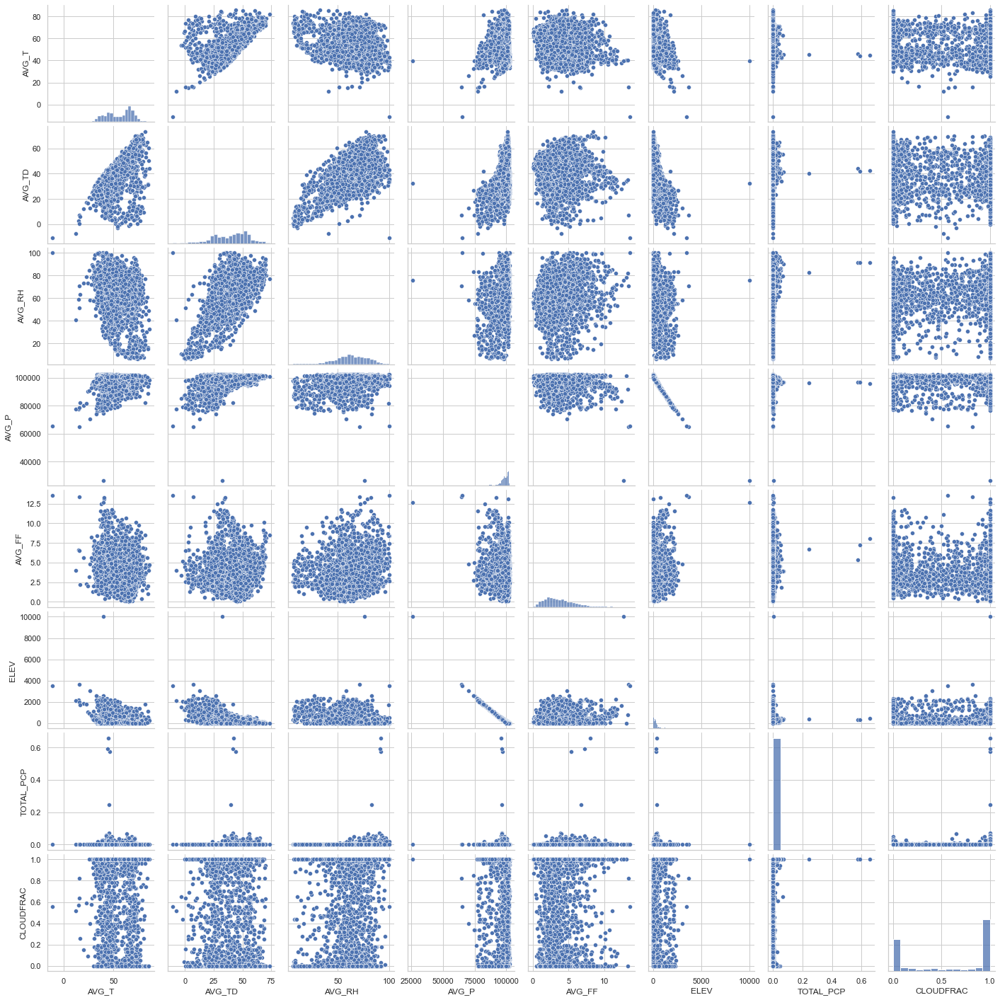

In [31]:
sns.pairplot(subset_avg);

In [32]:
print(subset_avg['CLOUDFRAC'].std())

0.4409109196679582


In [33]:
subset_avg.describe()

,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,ELEV,TOTAL_PCP,CLOUDFRAC
count,2712.000000,2712.000000,2712.000000,2712.000000,2712.000000,2712.000000,2712.000000,2712.000000
mean,56.149975,40.603645,62.148984,97554.497391,3.789469,337.181690,0.002230,0.586243
std,12.784294,14.219973,17.350662,5069.068086,2.172521,476.944993,0.021504,0.440911
min,-10.825011,-10.825011,6.197929,26348.584635,0.000000,0.000000,0.000000,0.000000
25%,45.188905,29.161656,52.505530,96488.428997,2.180032,61.750000,0.000000,0.030000
50%,59.242491,42.890158,62.870259,98844.287583,3.382071,202.000000,0.000000,0.840000
75%,66.724989,51.859021,74.669661,100894.849854,5.024107,380.000000,0.000000,1.000000
max,85.849989,73.549989,100.000000,102598.137370,13.547619,9999.000000,0.657400,1.000000


# Time to Panic!
OK, not really. But this looks like a logistic regression problem, not a linear one. The cloud fraction data is heavily skewed towards 0 (not cloudy at all) and 1 (completely cloudy).  

# Option 1: keep going anyway

In [34]:
# Splitting the subset data into train, val, and test
X, X_test, y, y_test = train_test_split(subset_avg[['AVG_T','AVG_TD','AVG_P','AVG_FF','TOTAL_PCP']], 
                                        subset_avg['CLOUDFRAC'], test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=42)

In [35]:
# Fit a simple linear regression on training set using r^2
lr_rsq = LinearRegression()
lr_rsq.fit(X_train,y_train)
r_squared = lr_rsq.score(X_train,y_train)
print('Score on training set: '+f'{r_squared:,.2f}')
print('Score on validation set: '+f'{lr_rsq.score(X_val,y_val):,.2f}')

Score on training set: 0.05
Score on validation set: 0.03


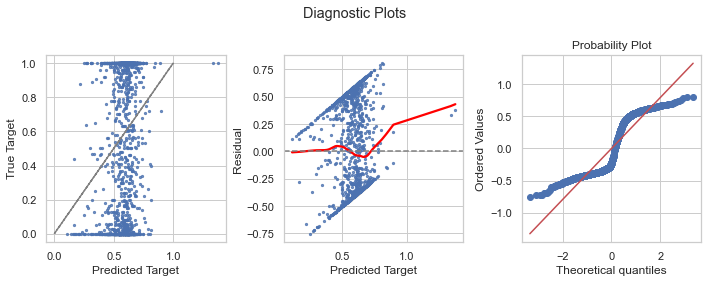

In [36]:
diagnostic_plots(lr_rsq.predict(X_train), y_train)

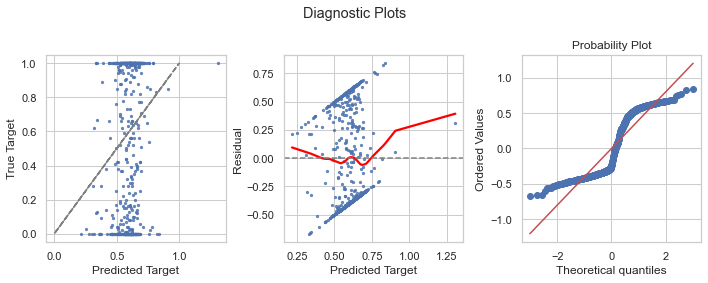

In [37]:
diagnostic_plots(lr_rsq.predict(X_val), y_val)

### Thoughts so far
So that step in the probability plot is just screaming __your target is categorical__. Which makes sense given that the distribution of cloud fraction data on this dataset is mostly ones and zeros. I'm impressed with the line fit, though. I'll try a polynomial model next, though I'm fairly certain it won't make much of a change.

In [38]:
from sklearn.preprocessing import PolynomialFeatures

In [39]:
# Create polynomial features
poly = PolynomialFeatures(degree=2)
X_train_poly = poly.fit_transform(X_train)

# Apply polynomial transformation to val set
X_val_poly = poly.transform(X_val)

# Fit a model using polynomial features
lr_rsq_poly = LinearRegression()
lr_rsq_poly.fit(X_train_poly,y_train)
print('Score on training set: '+f'{lr_rsq_poly.score(X_train_poly,y_train):,.2f}')
print('Score on validation set: '+f'{lr_rsq_poly.score(X_val_poly, y_val):,.2f}')

Score on training set: 0.15
Score on validation set: 0.12


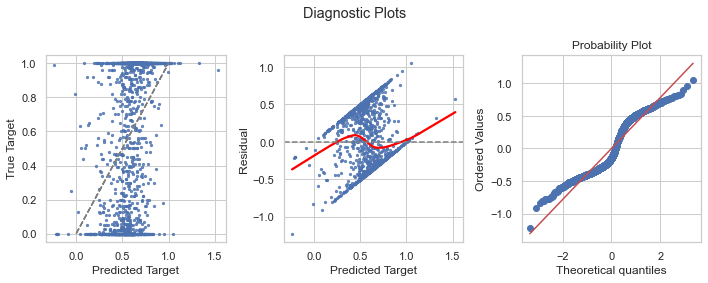

In [40]:
diagnostic_plots(lr_rsq_poly.predict(X_train_poly), y_train)

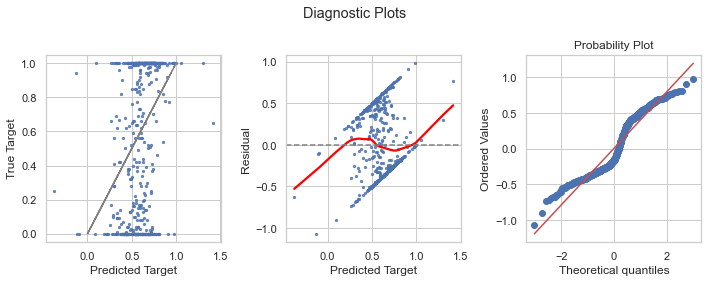

In [41]:
diagnostic_plots(lr_rsq_poly.predict(X_val_poly), y_val)

### Thought 2: can I introduce a bimodal variable? 

The cloud data might be influenced by something I haven't accounted for in the model. 

### Taking a look at the cloud data

In [42]:
import cartopy.crs as ccrs
from pathlib import Path
import plotly.express as px
import folium
import geopandas as gpd
from shapely.geometry import Point, Polygon
from pyproj import CRS

In [43]:
def date_from_cloudfiles(filename):
        fn = filename.name
        timestamp = pd.to_datetime(fn.split('_')[4].split('.')[0])
        return timestamp

In [44]:
clouds = sorted(Path("MYDAL/").glob("*.CSV"))

for cloud in clouds:
    timestamp = date_from_cloudfiles(cloud)
timestamp

Timestamp('2021-04-03 00:00:00')

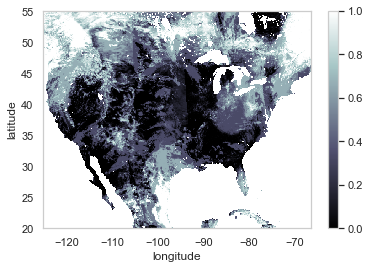

In [45]:
cloud_arrays = []
timestamps = []
water_mask_df = pd.read_csv('WATER_MASK.CSV', header=0, index_col=0, na_values=99999.0)

for cloud in clouds:
        timestamp = date_from_cloudfiles(cloud)
        timestamps.append(timestamp)
        
        cloud_df = pd.read_csv(cloud, header=0, index_col=0, na_values=99999.0)
        cloud_df = cloud_df.mask(water_mask_df.isna())
    
        cloud_df = cloud_df.round(2)
        cloud_df.columns = round_coords(cloud_df.columns)
        cloud_df.index = round_coords(cloud_df.index)
        cloud_da = xr.DataArray(cloud_df.values,
                coords=[[float(lat) for lat in cloud_df.index], [float(lon) for lon in cloud_df.columns]],
                dims=['latitude', 'longitude'])
        cloud_arrays.append(cloud_da)

cloud_da = xr.concat(cloud_arrays, pd.Index(timestamps, name='date'))
cloud_da

cloud_usa = cloud_da.loc[:, 55.05:20.05, -125.05:-66.50]
figure = cloud_usa.mean(dim='date').plot(cmap='bone');

Aha! That's a pretty extreme cloud pattern. There was apparently a massive weather front that day.

![title](images/NWS-map-0408.png)

In [46]:

def date_from_cloudfiles(filename):
        fn = filename.name
        timestamp = pd.to_datetime(fn.split('_')[4].split('.')[0])
        return timestamp
    
clouds = sorted(Path("MYDAL/").glob("*.CSV"))

for cloud in clouds:
    timestamp = date_from_cloudfiles(cloud)
timestamp

Timestamp('2021-04-03 00:00:00')

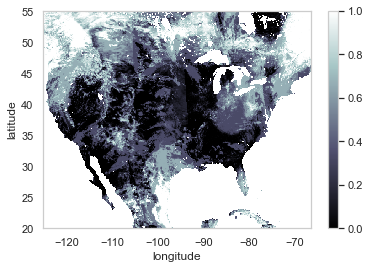

In [47]:
# Looking at 3-day average of cloud cover data
cloud_arrays = []
timestamps = []
water_mask_df = pd.read_csv('WATER_MASK.CSV', header=0, index_col=0, na_values=99999.0)

for cloud in clouds:
        timestamp = date_from_cloudfiles(cloud)
        timestamps.append(timestamp)
        
        cloud_df = pd.read_csv(cloud, header=0, index_col=0, na_values=99999.0)
        
        cloud_df = cloud_df.mask(water_mask_df.isna())
        
        cloud_df = cloud_df.round(2)
        cloud_df.columns = round_coords(cloud_df.columns)
        cloud_df.index = round_coords(cloud_df.index)
        cloud_da = xr.DataArray(cloud_df.values,
                coords=[[float(lat) for lat in cloud_df.index], [float(lon) for lon in cloud_df.columns]],
                dims=['latitude', 'longitude'])
        cloud_arrays.append(cloud_da)

cloud_da = xr.concat(cloud_arrays, pd.Index(timestamps, name='date'))
cloud_da

cloud_usa = cloud_da.loc[:, 55.05:20.05, -125.05:-66.50]
figure = cloud_usa.mean(dim='date').plot(cmap='bone');

In [74]:
fig = px.imshow(cloud_usa, animation_frame='date', color_continuous_scale=('Tan','PowderBlue', 'White'), aspect='equal', origin='lower', template="plotly_dark", title="3-day Average Cloud Cover in North America")
fig.layout.coloraxis.colorbar.title.side = 'bottom'
fig.update_layout(coloraxis_colorbar=dict(
    title="Cloud Cover Fraction",
    title_side = 'right',
    yanchor="top", y=1,
))

fig.show()

# Option 2: Getting more data
I scraped more MADIS data and now I'm going to fit a model on average observations over __three days__ in order to predict a __three-day average__ of the target (cloud fraction).

In [49]:
# Processing day 1
raw_stations_0329 = pd.read_csv('madis_scrape_2021_03_29.csv', header=0, na_values=-99999.0, parse_dates=[['OBDATE', 'OBTIME']], keep_date_col=True)

# rename the datetime column
raw_stations_0329.rename(columns={'OBDATE_OBTIME': 'OBSERVATION'}, inplace=True)

# parse QC flags by looking at rows with X (rejected), Q (questioned), B (subjective bad) values in D-D.11
flagged_0329 = raw_stations_0329.isin(['X', 'Q', 'B']).any()

stations_hourly_0329 = raw_stations_0329[['STAID', 'T', 'TD', 'RH', 'P', 'FF', 'VIS', 'PCP1H', 'PCP24H', 'LAT', 'LON', 'ELEV', 'OBSERVATION', 'OBDATE', 'OBTIME']].copy()

stations_hourly_0329['OBDATE'] = stations_hourly_0329['OBDATE'].map({'03/30/2021': '03/29/2021', '03/29/2021': '03/29/2021'})

daily_avg_0329 = stations_hourly_0329.groupby('STAID').mean().reset_index()

avg_names_0329 = [(name, 'AVG_'+name) for name in daily_avg_0329.iloc[:, 1:8].columns.values]
daily_avg_0329.rename(columns = dict(avg_names_0329), inplace=True)

daily_avg_0329.drop(columns=['AVG_PCP1H','PCP24H'], inplace=True)

daily_sum_0329 = stations_hourly_0329.groupby('STAID').sum().reset_index()
total_pcp_0329 = daily_sum_0329[['STAID','PCP1H']]
total_pcp_0329 = total_pcp_0329.rename(columns={'PCP1H': 'TOTAL_PCP'})

daily_avg_0329['TOTAL_PCP'] = total_pcp_0329['TOTAL_PCP']

# add minimum reported values to the dataset
daily_min_0329 = stations_hourly_0329.groupby('STAID').min().reset_index()
min_td_0329 = daily_min_0329[['STAID','TD']]
min_t_0329 = daily_min_0329[['STAID','T']]
min_p_0329 = daily_min_0329[['STAID','P']]
daily_avg_0329['MIN_TD'] = min_td_0329['TD']
daily_avg_0329['MIN_T'] = min_t_0329['T']
daily_avg_0329['MIN_P'] = min_p_0329['P']

# add maximum reported values to the dataset
daily_max_0329 = stations_hourly_0329.groupby('STAID').max().reset_index()
max_td_0329 = daily_max_0329[['STAID','TD']]
max_t_0329 = daily_max_0329[['STAID','T']]
max_p_0329 = daily_max_0329[['STAID','P']]
daily_avg_0329['MAX_TD'] = max_td_0329['TD']
daily_avg_0329['MAX_T'] = max_t_0329['T']
daily_avg_0329['MAX_P'] = max_p_0329['P']

# Station lat/lon hack:

daily_avg_0329['LAT'] = daily_avg_0329['LAT'].apply(lambda x: '{:.2f}'.format(x))
daily_avg_0329['LON'] = daily_avg_0329['LON'].apply(lambda x: '{:.2f}'.format(x)) 

daily_avg_0329['LAT'] = daily_avg_0329['LAT'].apply(lambda x: adjust(x))
daily_avg_0329['LON'] = daily_avg_0329['LON'].apply(lambda x: adjust(x))                                     

adj_station_daily_0329 = daily_avg_0329

# Look for out of bounds values
low_lon_0329 = adj_station_daily_0329['LON'][adj_station_daily_0329['LON'].astype(float) < -180]
high_lon_0329 = adj_station_daily_0329['LON'][adj_station_daily_0329['LON'].astype(float) > 180]

# Get names of indexes for which longitude is out of bounds
index_names_0329 = adj_station_daily_0329[adj_station_daily_0329['LON'].astype(float) < -180].index
index_names_0329

# Delete these row indexes 
adj_station_daily_0329.drop(index_names_0329 , inplace=True)
features_0329 = adj_station_daily_0329

station_lat_0329 = adj_station_daily_0329['LAT'].tolist()
station_lon_0329 = adj_station_daily_0329['LON'].tolist()

# Read in cloud data
cloudfr_df_0329 = pd.read_csv('test_modis/MYDAL2_D_CLD_FR_2021-04-01_rgb_3600x1800.SS.CSV', header=0, index_col=0, na_values=99999.0)
cloudfr_df_0329 = cloudfr_df_0329.round(2)
cloudfr_df_0329.columns = round_coords(cloudfr_df_0329.columns, 2)
cloudfr_df_0329.index = round_coords(cloudfr_df_0329.index, 2)
cloudfr_values_0329 = cloudfr_df_0329.lookup(station_lat_0329, station_lon_0329)

features_0329['CLOUDFRAC'] = cloudfr_values_0329
# Split out station data for mapping
station_data_0329 = features_0329.dropna().reset_index()

# Name modeling dataset
weather_data_0329 = features_0329.dropna().reset_index()
weather_data_0329

# Convert Kelvin to Fehrenheit
weather_data_0329['AVG_T'] = weather_data_0329['AVG_T'].apply(lambda x: kelvin_to_f(x))
weather_data_0329['MIN_T'] = weather_data_0329['MIN_T'].apply(lambda x: kelvin_to_f(x))
weather_data_0329['MAX_T'] = weather_data_0329['MAX_T'].apply(lambda x: kelvin_to_f(x))
weather_data_0329['AVG_TD'] = weather_data_0329['AVG_TD'].apply(lambda x: kelvin_to_f(x))
weather_data_0329['MIN_TD'] = weather_data_0329['MIN_TD'].apply(lambda x: kelvin_to_f(x))
weather_data_0329['MAX_TD'] = weather_data_0329['MAX_TD'].apply(lambda x: kelvin_to_f(x))

# Drop non-feature columns
# weather_data_0329 = weather_data.drop(columns=['LAT', 'LON', 'ELEV'])
# weather_data_0329.shape

weather_data_0329 = weather_data_0329.drop(columns=['index'])


/var/folders/_g/0w700wks7s1f9mzvhbcn7vvc0000gn/T/ipykernel_37784/1457680827.py:75: FutureWarning:

The 'lookup' method is deprecated and will beremoved in a future version.You can use DataFrame.melt and DataFrame.locas a substitute.



In [50]:
# Processing day 2
raw_stations_0330 = pd.read_csv('madis_scrape_2021_03_30.csv', header=0, na_values=-99999.0, parse_dates=[['OBDATE', 'OBTIME']], keep_date_col=True)

# rename the datetime column
raw_stations_0330.rename(columns={'OBDATE_OBTIME': 'OBSERVATION'}, inplace=True)

# parse QC flags by looking at rows with X (rejected), Q (questioned), B (subjective bad) values in D-D.11
flagged_0330 = raw_stations_0330.isin(['X', 'Q', 'B']).any()

stations_hourly_0330 = raw_stations_0330[['STAID', 'T', 'TD', 'RH', 'P', 'FF', 'VIS', 'PCP1H', 'PCP24H', 'LAT', 'LON', 'ELEV', 'OBSERVATION', 'OBDATE', 'OBTIME']].copy()

stations_hourly_0330['OBDATE'] = stations_hourly_0330['OBDATE'].map({'03/31/2021': '03/30/2021', '03/30/2021': '03/30/2021'})

daily_avg_0330 = stations_hourly_0330.groupby('STAID').mean().reset_index()

avg_names_0330 = [(name, 'AVG_'+name) for name in daily_avg_0330.iloc[:, 1:8].columns.values]
daily_avg_0330.rename(columns = dict(avg_names_0330), inplace=True)

daily_avg_0330.drop(columns=['AVG_PCP1H','PCP24H'], inplace=True)

daily_sum_0330 = stations_hourly_0330.groupby('STAID').sum().reset_index()
total_pcp_0330 = daily_sum_0330[['STAID','PCP1H']]
total_pcp_0330 = total_pcp_0330.rename(columns={'PCP1H': 'TOTAL_PCP'})

daily_avg_0330['TOTAL_PCP'] = total_pcp_0330['TOTAL_PCP']

# add minimum reported values to the dataset
daily_min_0330 = stations_hourly_0330.groupby('STAID').min().reset_index()
min_td_0330 = daily_min_0330[['STAID','TD']]
min_t_0330 = daily_min_0330[['STAID','T']]
min_p_0330 = daily_min_0330[['STAID','P']]
daily_avg_0330['MIN_TD'] = min_td_0330['TD']
daily_avg_0330['MIN_T'] = min_t_0330['T']
daily_avg_0330['MIN_P'] = min_p_0330['P']

# add maximum reported values to the dataset
daily_max_0330 = stations_hourly_0330.groupby('STAID').max().reset_index()
max_td_0330 = daily_max_0330[['STAID','TD']]
max_t_0330 = daily_max_0330[['STAID','T']]
max_p_0330 = daily_max_0330[['STAID','P']]
daily_avg_0330['MAX_TD'] = max_td_0330['TD']
daily_avg_0330['MAX_T'] = max_t_0330['T']
daily_avg_0330['MAX_P'] = max_p_0330['P']

# Station lat/lon hack:

daily_avg_0330['LAT'] = daily_avg_0330['LAT'].apply(lambda x: '{:.2f}'.format(x))
daily_avg_0330['LON'] = daily_avg_0330['LON'].apply(lambda x: '{:.2f}'.format(x)) 

daily_avg_0330['LAT'] = daily_avg_0330['LAT'].apply(lambda x: adjust(x))
daily_avg_0330['LON'] = daily_avg_0330['LON'].apply(lambda x: adjust(x))                                     

adj_station_daily_0330 = daily_avg_0330

# Look for out of bounds values
low_lon_0330 = adj_station_daily_0330['LON'][adj_station_daily_0330['LON'].astype(float) < -180]
high_lon_0330 = adj_station_daily_0330['LON'][adj_station_daily_0330['LON'].astype(float) > 180]

# Get names of indexes for which longitude is out of bounds
index_names_0330 = adj_station_daily_0330[adj_station_daily_0330['LON'].astype(float) < -180].index
index_names_0330

# Delete these row indexes 
adj_station_daily_0330.drop(index_names_0330 , inplace=True)
features_0330 = adj_station_daily_0330

station_lat_0330 = adj_station_daily_0330['LAT'].tolist()
station_lon_0330 = adj_station_daily_0330['LON'].tolist()

# Read in cloud data
cloudfr_df_0330 = pd.read_csv('test_modis/MYDAL2_D_CLD_FR_2021-04-02_rgb_3600x1800.SS.CSV', header=0, index_col=0, na_values=99999.0)
cloudfr_df_0330 = cloudfr_df_0330.round(2)
cloudfr_df_0330.columns = round_coords(cloudfr_df_0330.columns, 2)
cloudfr_df_0330.index = round_coords(cloudfr_df_0330.index, 2)
cloudfr_values_0330 = cloudfr_df_0330.lookup(station_lat_0330, station_lon_0330)

features_0330['CLOUDFRAC'] = cloudfr_values_0330
# Split out station data for mapping
station_data_0330 = features_0330.dropna().reset_index()

# Name modeling dataset
weather_data_0330 = features_0330.dropna().reset_index()
weather_data_0330

# Convert Kelvin to Fehrenheit
weather_data_0330['AVG_T'] = weather_data_0330['AVG_T'].apply(lambda x: kelvin_to_f(x))
weather_data_0330['MIN_T'] = weather_data_0330['MIN_T'].apply(lambda x: kelvin_to_f(x))
weather_data_0330['MAX_T'] = weather_data_0330['MAX_T'].apply(lambda x: kelvin_to_f(x))
weather_data_0330['AVG_TD'] = weather_data_0330['AVG_TD'].apply(lambda x: kelvin_to_f(x))
weather_data_0330['MIN_TD'] = weather_data_0330['MIN_TD'].apply(lambda x: kelvin_to_f(x))
weather_data_0330['MAX_TD'] = weather_data_0330['MAX_TD'].apply(lambda x: kelvin_to_f(x))

# Drop non-feature columns
# weather_data_0330 = weather_data.drop(columns=['LAT', 'LON', 'ELEV'])
# weather_data_0330.shape

weather_data_0330 = weather_data_0330.drop(columns=['index'])


/var/folders/_g/0w700wks7s1f9mzvhbcn7vvc0000gn/T/ipykernel_37784/1827460793.py:28: FutureWarning:

Dropping invalid columns in DataFrameGroupBy.min is deprecated. In a future version, a TypeError will be raised. Before calling .min, select only columns which should be valid for the function.

/var/folders/_g/0w700wks7s1f9mzvhbcn7vvc0000gn/T/ipykernel_37784/1827460793.py:37: FutureWarning:

Dropping invalid columns in DataFrameGroupBy.max is deprecated. In a future version, a TypeError will be raised. Before calling .max, select only columns which should be valid for the function.

/var/folders/_g/0w700wks7s1f9mzvhbcn7vvc0000gn/T/ipykernel_37784/1827460793.py:75: FutureWarning:

The 'lookup' method is deprecated and will beremoved in a future version.You can use DataFrame.melt and DataFrame.locas a substitute.



In [51]:
# Processing day 3
raw_stations_0331 = pd.read_csv('madis_scrape_2021_03_31.csv', header=0, na_values=-99999.0, parse_dates=[['OBDATE', 'OBTIME']], keep_date_col=True)

# rename the datetime column
raw_stations_0331.rename(columns={'OBDATE_OBTIME': 'OBSERVATION'}, inplace=True)

# parse QC flags by looking at rows with X (rejected), Q (questioned), B (subjective bad) values in D-D.11
flagged_0331 = raw_stations_0331.isin(['X', 'Q', 'B']).any()

stations_hourly_0331 = raw_stations_0331[['STAID', 'T', 'TD', 'RH', 'P', 'FF', 'VIS', 'PCP1H', 'PCP24H', 'LAT', 'LON', 'ELEV', 'OBSERVATION', 'OBDATE', 'OBTIME']].copy()

stations_hourly_0331['OBDATE'] = stations_hourly_0331['OBDATE'].map({'04/01/2021': '03/31/2021', '03/31/2021': '03/31/2021'})

daily_avg_0331 = stations_hourly_0331.groupby('STAID').mean().reset_index()

avg_names_0331 = [(name, 'AVG_'+name) for name in daily_avg_0331.iloc[:, 1:8].columns.values]
daily_avg_0331.rename(columns = dict(avg_names_0331), inplace=True)

daily_avg_0331.drop(columns=['AVG_PCP1H','PCP24H'], inplace=True)

daily_sum_0331 = stations_hourly_0331.groupby('STAID').sum().reset_index()
total_pcp_0331 = daily_sum_0331[['STAID','PCP1H']]
total_pcp_0331 = total_pcp_0331.rename(columns={'PCP1H': 'TOTAL_PCP'})

daily_avg_0331['TOTAL_PCP'] = total_pcp_0331['TOTAL_PCP']

# add minimum reported values to the dataset
daily_min_0331 = stations_hourly_0331.groupby('STAID').min().reset_index()
min_td_0331 = daily_min_0331[['STAID','TD']]
min_t_0331 = daily_min_0331[['STAID','T']]
min_p_0331 = daily_min_0331[['STAID','P']]
daily_avg_0331['MIN_TD'] = min_td_0331['TD']
daily_avg_0331['MIN_T'] = min_t_0331['T']
daily_avg_0331['MIN_P'] = min_p_0331['P']

# add maximum reported values to the dataset
daily_max_0331 = stations_hourly_0331.groupby('STAID').max().reset_index()
max_td_0331 = daily_max_0331[['STAID','TD']]
max_t_0331 = daily_max_0331[['STAID','T']]
max_p_0331 = daily_max_0331[['STAID','P']]
daily_avg_0331['MAX_TD'] = max_td_0331['TD']
daily_avg_0331['MAX_T'] = max_t_0331['T']
daily_avg_0331['MAX_P'] = max_p_0331['P']

# Station lat/lon hack:

daily_avg_0331['LAT'] = daily_avg_0331['LAT'].apply(lambda x: '{:.2f}'.format(x))
daily_avg_0331['LON'] = daily_avg_0331['LON'].apply(lambda x: '{:.2f}'.format(x)) 

daily_avg_0331['LAT'] = daily_avg_0331['LAT'].apply(lambda x: adjust(x))
daily_avg_0331['LON'] = daily_avg_0331['LON'].apply(lambda x: adjust(x))                                     

adj_station_daily_0331 = daily_avg_0331

# Look for out of bounds values
low_lon_0331 = adj_station_daily_0331['LON'][adj_station_daily_0331['LON'].astype(float) < -180]
high_lon_0331 = adj_station_daily_0331['LON'][adj_station_daily_0331['LON'].astype(float) > 180]

# Get names of indexes for which longitude is out of bounds
index_names_0331 = adj_station_daily_0331[adj_station_daily_0331['LON'].astype(float) < -180].index
index_names_0331

# Delete these row indexes 
adj_station_daily_0331.drop(index_names_0331 , inplace=True)
features_0331 = adj_station_daily_0331

station_lat_0331 = adj_station_daily_0331['LAT'].tolist()
station_lon_0331 = adj_station_daily_0331['LON'].tolist()

# Read in cloud data
cloudfr_df_0331 = pd.read_csv('test_modis/MYDAL2_D_CLD_FR_2021-04-03_rgb_3600x1800.SS.CSV', header=0, index_col=0, na_values=99999.0)
cloudfr_df_0331 = cloudfr_df_0331.round(2)
cloudfr_df_0331.columns = round_coords(cloudfr_df_0331.columns, 2)
cloudfr_df_0331.index = round_coords(cloudfr_df_0331.index, 2)
cloudfr_values_0331 = cloudfr_df_0331.lookup(station_lat_0331, station_lon_0331)

features_0331['CLOUDFRAC'] = cloudfr_values_0331
# Split out station data for mapping
station_data_0331 = features_0331.dropna().reset_index()

# Name modeling dataset
weather_data_0331 = features_0331.dropna().reset_index()
weather_data_0331

# Convert Kelvin to Fehrenheit
weather_data_0331['AVG_T'] = weather_data_0331['AVG_T'].apply(lambda x: kelvin_to_f(x))
weather_data_0331['MIN_T'] = weather_data_0331['MIN_T'].apply(lambda x: kelvin_to_f(x))
weather_data_0331['MAX_T'] = weather_data_0331['MAX_T'].apply(lambda x: kelvin_to_f(x))
weather_data_0331['AVG_TD'] = weather_data_0331['AVG_TD'].apply(lambda x: kelvin_to_f(x))
weather_data_0331['MIN_TD'] = weather_data_0331['MIN_TD'].apply(lambda x: kelvin_to_f(x))
weather_data_0331['MAX_TD'] = weather_data_0331['MAX_TD'].apply(lambda x: kelvin_to_f(x))

# Drop non-feature columns
# weather_data_0331 = weather_data.drop(columns=['LAT', 'LON', 'ELEV'])
# weather_data_0331.shape

weather_data_0331 = weather_data_0331.drop(columns=['index'])

weather_data_0331

/var/folders/_g/0w700wks7s1f9mzvhbcn7vvc0000gn/T/ipykernel_37784/1068089475.py:75: FutureWarning:

The 'lookup' method is deprecated and will beremoved in a future version.You can use DataFrame.melt and DataFrame.locas a substitute.



,STAID,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,AVG_VIS,LAT,LON,ELEV,TOTAL_PCP,MIN_TD,MIN_T,MIN_P,MAX_TD,MAX_T,MAX_P,CLOUDFRAC
0,CWAE,41.969220,28.953835,63.440510,94858.505409,0.692308,24140.000000,50.15,-122.95,657.0,0.0,26.599989,30.199989,94341.585938,30.199989,53.599989,95167.507812,1.00
1,CWHN,25.399989,10.324989,53.460553,94051.705404,3.225000,14480.000000,54.95,-109.95,637.0,0.0,1.399989,12.199989,93806.851562,24.799989,46.399989,94220.570312,1.00
2,CWLY,45.199989,29.974989,56.762029,99961.547852,5.585714,14480.000000,50.55,-121.55,228.0,0.0,28.399989,33.799989,99110.804688,31.999989,60.799989,100265.250000,1.00
3,CWSA,39.049989,34.999989,85.609167,102992.058919,4.925000,14077.916667,45.95,-65.55,5.0,0.0,30.199989,35.599989,102539.359375,37.399989,44.599989,103219.015625,1.00
4,CWSW,39.799989,17.461528,46.253443,89788.000000,2.966667,32190.000000,49.75,-114.55,1137.0,0.0,8.599989,24.799989,89788.000000,22.999989,48.199989,89788.000000,0.78
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2091,MUSC,78.724989,68.374989,73.320599,100598.328125,4.412500,8958.333333,22.55,-79.95,103.0,0.0,64.399989,69.799989,100297.164062,71.599989,91.399989,100792.226562,1.00
2092,MUVR,80.149989,69.949989,72.853713,101044.559245,4.529167,9000.000000,25.05,-81.45,65.0,0.0,66.199989,75.199989,100750.554688,71.599989,89.599989,101247.445312,0.35
2093,MYGF,78.349989,70.549989,77.522118,101938.848307,4.929167,10000.000000,26.55,-78.75,11.0,0.0,67.999989,75.199989,101697.445312,71.599989,82.399989,102136.968750,0.98
2094,MYNN,79.290898,67.999989,69.207959,101995.004617,6.263636,10000.000000,25.05,-55.45,7.0,0.0,64.399989,75.199989,101745.617188,71.599989,84.199989,102185.320312,0.15


In [52]:
weather_data_3day = pd.concat([weather_data_0329, weather_data_0330, weather_data_0331]).groupby("STAID").mean().reset_index()


# Modeling using 3-day averages

In [53]:
subset_avg_3day = weather_data_3day.drop(columns=['MIN_T', 'MIN_TD', 'MIN_P', 'MAX_T', 'MAX_TD', 'MAX_P'])
subset_avg_3day

,STAID,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,AVG_VIS,ELEV,TOTAL_PCP,CLOUDFRAC
0,CWAE,36.384605,24.199989,65.353553,94816.151843,0.586325,24016.153846,657.0,0.0,0.883333
1,CWHN,20.706807,7.640898,57.699131,93511.186957,4.749495,12000.845960,637.0,0.0,0.960000
2,CWLY,39.536353,29.268863,70.481688,99764.320020,3.489821,14161.666667,228.0,0.0,0.883333
3,CWSA,39.677262,33.490898,79.614130,101857.327326,9.377146,11250.984848,5.0,0.0,1.000000
4,CWSW,31.646143,17.507682,60.535960,88913.300781,3.045043,23728.717949,1137.0,0.0,0.633333
...,...,...,...,...,...,...,...,...,...,...
2124,MUSC,78.649989,68.824989,74.214908,100614.830566,4.856250,8979.166667,103.0,0.0,0.735000
2125,MUVR,79.074989,69.749989,74.743859,101056.984375,4.519444,8875.000000,65.0,0.0,0.450000
2126,MYGF,77.824989,69.924989,77.293230,101925.248698,3.973611,10000.000000,11.0,0.0,0.936667
2127,MYNN,79.786620,68.847048,69.991740,102041.966922,5.978877,10000.000000,7.0,0.0,0.205000


In [54]:
subset_avg_3day.describe()

,AVG_T,AVG_TD,AVG_RH,AVG_P,AVG_FF,AVG_VIS,ELEV,TOTAL_PCP,CLOUDFRAC
count,2129.000000,2129.000000,2129.000000,2129.000000,2129.000000,2129.000000,2129.000000,2129.000000,2129.000000
mean,51.585964,33.075382,55.124728,97487.796245,4.570515,15707.503588,373.562155,0.001302,0.393107
std,12.912741,15.181679,14.999075,5447.343101,1.964777,2993.385175,512.664753,0.003234,0.302959
min,3.965898,-2.615920,5.183772,26812.657593,0.455556,2010.000000,0.000000,0.000000,0.000000
25%,42.826245,22.156246,46.171502,96717.008464,3.022807,15086.198288,75.000000,0.000000,0.113333
50%,51.303743,31.283815,56.529261,98961.322917,4.332750,15790.047869,227.000000,0.000000,0.340000
75%,61.169996,42.928911,65.271732,100980.424805,5.820366,16090.000000,396.000000,0.000818,0.646667
max,83.036253,72.207502,96.859044,102805.813097,14.033333,61866.944444,9999.000000,0.058000,1.000000


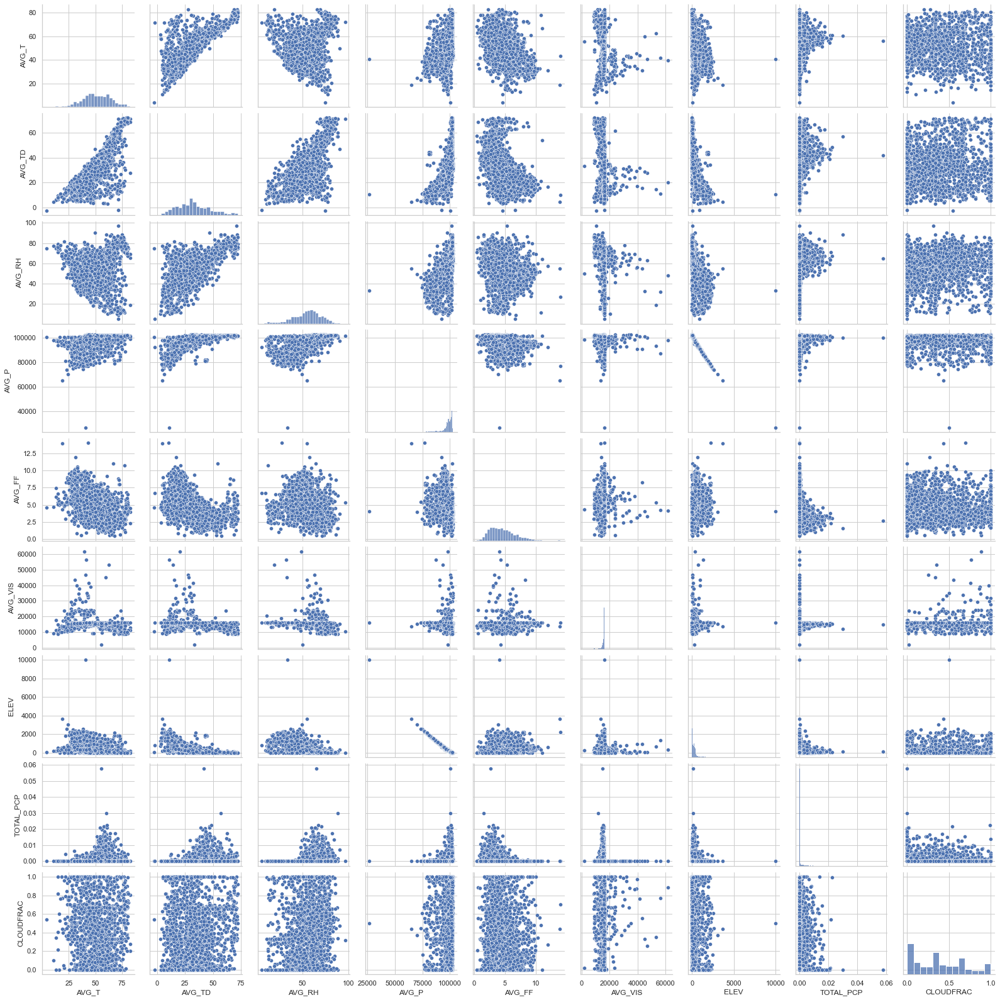

In [55]:
sns.pairplot(subset_avg_3day);

Score on training set: 0.07
Score on validation set: 0.04


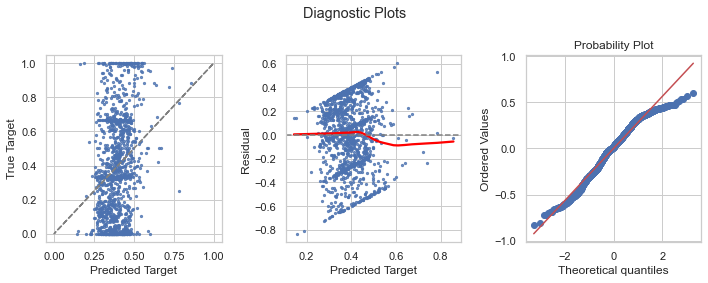

In [56]:
# Splitting the subset data into train, val, and test
X, X_test, y, y_test = train_test_split(subset_avg_3day[['AVG_T','AVG_TD','AVG_RH','AVG_P','AVG_FF','AVG_VIS','TOTAL_PCP']], 
                                        subset_avg_3day['CLOUDFRAC'], test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=42)

# Fit a simple linear regression on training set using r^2
lr_rsq = LinearRegression()
lr_rsq.fit(X_train,y_train)
r_squared = lr_rsq.score(X_train,y_train)
print('Score on training set: '+f'{r_squared:,.2f}')
print('Score on validation set: '+f'{lr_rsq.score(X_val,y_val):,.2f}')

diagnostic_plots(lr_rsq.predict(X_train), y_train)

Definitely a little bit of an improvement. Now I look at smaller variable subsets:

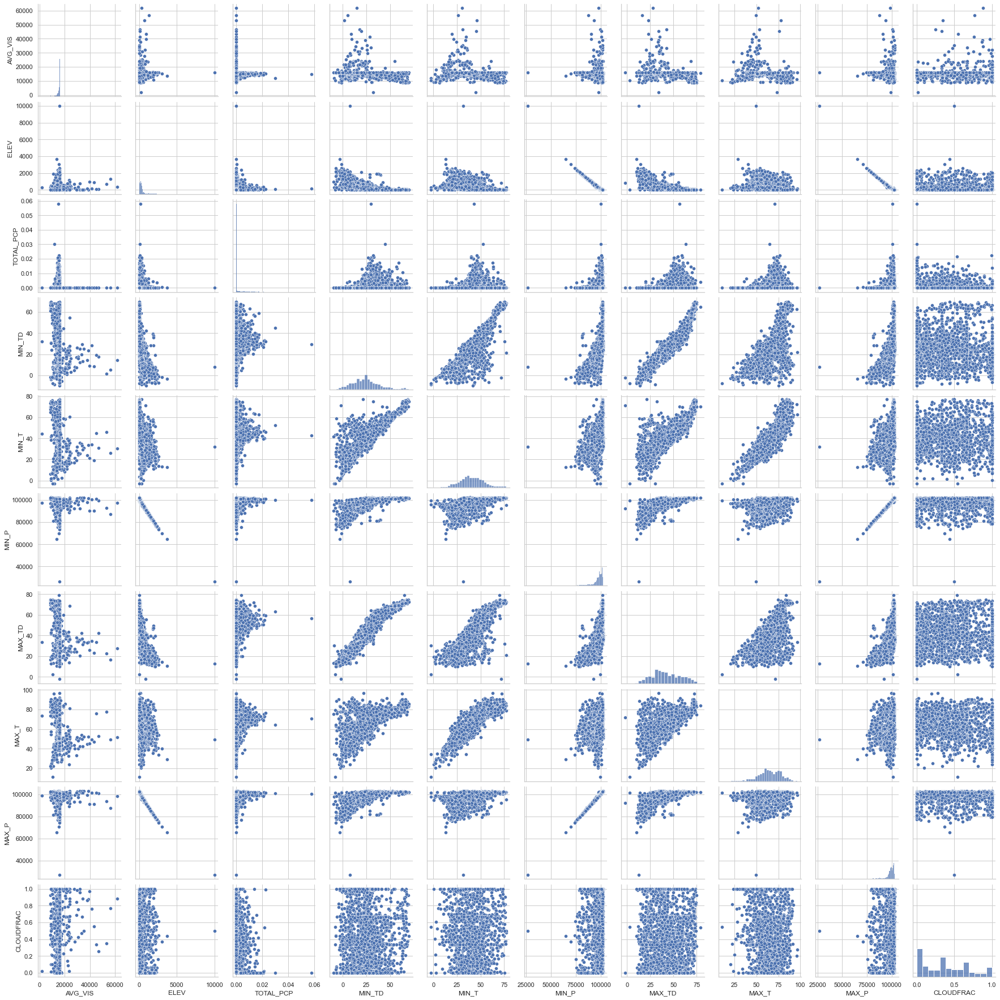

In [57]:
subset_minmax_3day = weather_data_3day.drop(columns=['AVG_T', 'AVG_TD', 'AVG_P', 'AVG_RH', 'AVG_FF'])
subset_minmax_3day
sns.pairplot(subset_minmax_3day);

Score on training set: 0.05
Score on validation set: 0.04


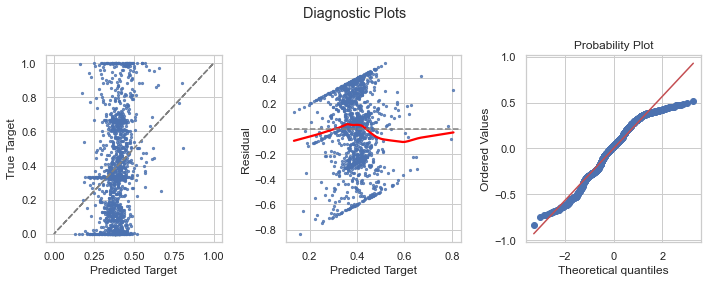

In [58]:
# Splitting the subset data into train, val, and test
X, X_test, y, y_test = train_test_split(subset_minmax_3day[['AVG_VIS','ELEV','MIN_TD','MIN_P','MIN_T','MAX_TD','MAX_T','MAX_P','TOTAL_PCP']], 
                                        subset_minmax_3day['CLOUDFRAC'], test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=42)

# Fit a simple linear regression on training set using r^2
lr_rsq = LinearRegression()
lr_rsq.fit(X_train,y_train)
r_squared = lr_rsq.score(X_train,y_train)
print('Score on training set: '+f'{r_squared:,.2f}')
print('Score on validation set: '+f'{lr_rsq.score(X_val,y_val):,.2f}')

diagnostic_plots(lr_rsq.predict(X_train), y_train)

Interesting. Obviously a lot of correlation between min/max variables. Just from the pairplot, I'm thinking visibility might be a decent thing to look at? 

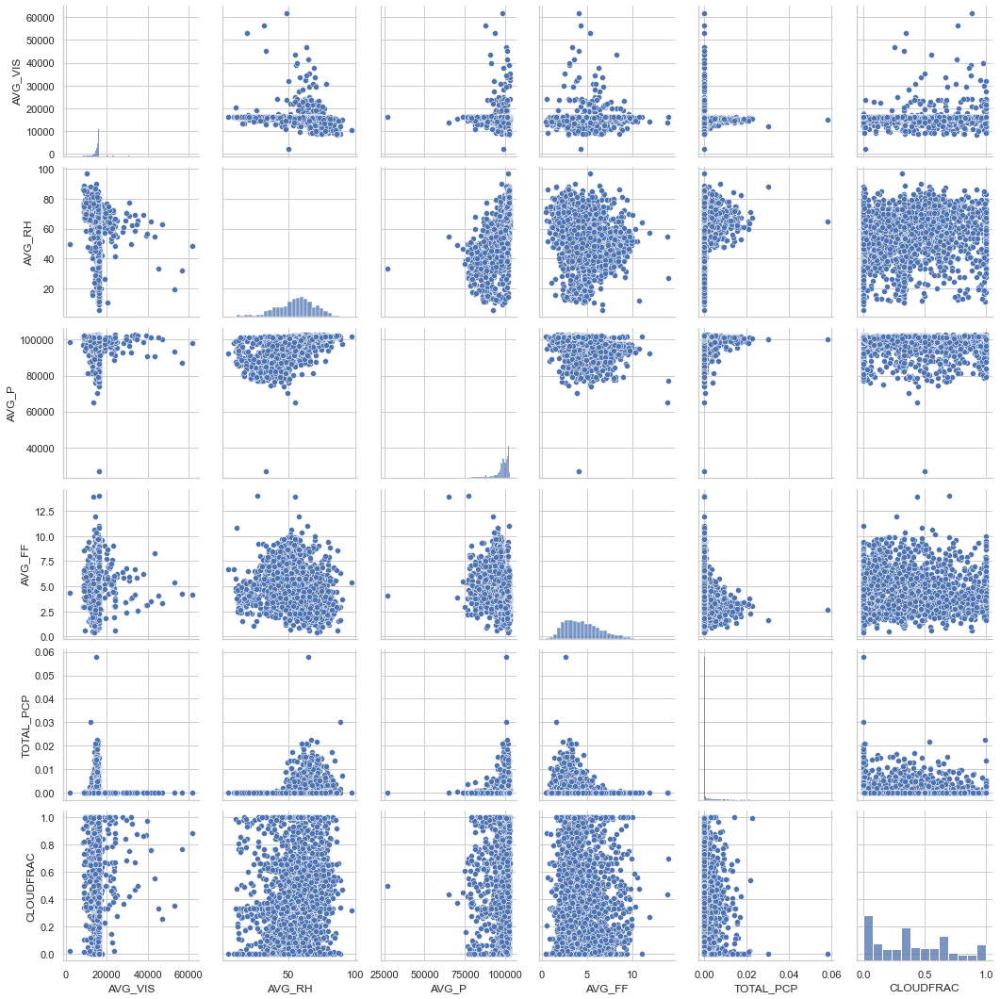

In [59]:
subset_test_3day = weather_data_3day[['AVG_VIS', 'AVG_RH', 'AVG_P', 'AVG_FF', 'TOTAL_PCP', 'CLOUDFRAC']].copy()

sns.pairplot(subset_test_3day);

Pretty rough. But let's see the scores:

Score on training set: 0.06
Score on validation set: 0.02


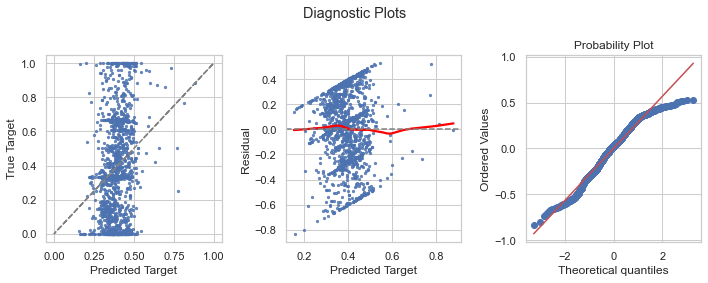

In [60]:
# Splitting the subset data into train, val, and test
X, X_test, y, y_test = train_test_split(subset_test_3day[['AVG_VIS', 'AVG_RH', 'AVG_P', 'AVG_FF', 'TOTAL_PCP']], 
                                        subset_test_3day['CLOUDFRAC'], test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=42)

# Fit a simple linear regression on training set using r^2
lr_rsq = LinearRegression()
lr_rsq.fit(X_train,y_train)
r_squared = lr_rsq.score(X_train,y_train)
print('Score on training set: '+f'{r_squared:,.2f}')
print('Score on validation set: '+f'{lr_rsq.score(X_val,y_val):,.2f}')

diagnostic_plots(lr_rsq.predict(X_train), y_train)

Eh. 

# Scaling

In [61]:
from sklearn.linear_model import LinearRegression, Lasso, LassoCV, Ridge, RidgeCV
from sklearn.metrics import mean_absolute_error as mae
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

In [62]:
# Splitting the data into train, val, and test
X, X_test, y, y_test = train_test_split(weather_data_3day[['AVG_T','AVG_TD','AVG_RH','AVG_P','AVG_FF','AVG_VIS','TOTAL_PCP','ELEV','MIN_TD','MIN_P','MIN_T','MAX_TD','MAX_T','MAX_P']], 
                                        weather_data_3day['CLOUDFRAC'], test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=42)

# Fit a simple linear regression on training set using r^2
lr_rsq = LinearRegression()
lr_rsq.fit(X_train,y_train)
r_squared = lr_rsq.score(X_train,y_train)
print('Score on training set: '+f'{r_squared:,.2f}')
print('Score on validation set: '+f'{lr_rsq.score(X_val,y_val):,.2f}')

Score on training set: 0.12
Score on validation set: 0.05


In [63]:
std = StandardScaler()
std.fit(X_train.values)

StandardScaler()

In [64]:
X_tr = std.transform(X_train.values)
X_te = std.transform(X_test.values)

/Users/noether/miniforge3/envs/eclipse/lib/python3.10/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



<AxesSubplot:>

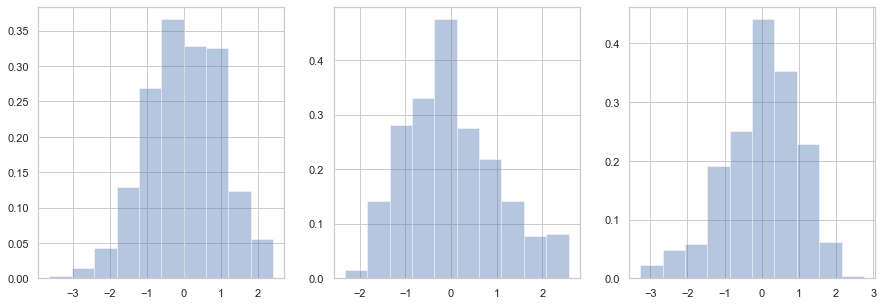

In [65]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

sns.distplot(X_tr[:, 0], label='feature 1', ax=axes[0], kde=False, bins=10, norm_hist=True)
sns.distplot(X_tr[:, 1], label='feature 2', ax=axes[1], kde=False, bins=10, norm_hist=True)
sns.distplot(X_tr[:, 2], label='feature 3', ax=axes[2], kde=False, bins=10, norm_hist=True)

In [66]:
alphavec = 10**np.linspace(-2,2,200)

lasso_model = LassoCV(alphas = alphavec, cv=5)
lasso_model.fit(X_tr, y_train)

LassoCV(alphas=array([1.00000000e-02, 1.04737090e-02, 1.09698580e-02, 1.14895100e-02,
       1.20337784e-02, 1.26038293e-02, 1.32008840e-02, 1.38262217e-02,
       1.44811823e-02, 1.51671689e-02, 1.58856513e-02, 1.66381689e-02,
       1.74263339e-02, 1.82518349e-02, 1.91164408e-02, 2.00220037e-02,
       2.09704640e-02, 2.19638537e-02, 2.30043012e-02, 2.40940356e-02,
       2.52353917e-02, 2.64308149e-0...
       3.44896226e+01, 3.61234270e+01, 3.78346262e+01, 3.96268864e+01,
       4.15040476e+01, 4.34701316e+01, 4.55293507e+01, 4.76861170e+01,
       4.99450512e+01, 5.23109931e+01, 5.47890118e+01, 5.73844165e+01,
       6.01027678e+01, 6.29498899e+01, 6.59318827e+01, 6.90551352e+01,
       7.23263390e+01, 7.57525026e+01, 7.93409667e+01, 8.30994195e+01,
       8.70359136e+01, 9.11588830e+01, 9.54771611e+01, 1.00000000e+02]),
        cv=5)

In [67]:
lasso_model.alpha_

0.01

In [68]:
# Splitting the minmax data into train, val, and test
X, X_test, y, y_test = train_test_split(subset_minmax_3day[['AVG_VIS','ELEV','MIN_TD','MIN_P','MIN_T','MAX_TD','MAX_T','MAX_P','TOTAL_PCP']], 
                                        subset_minmax_3day['CLOUDFRAC'], test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.25, random_state=42)

# Fit a simple linear regression on training set using r^2
lr_rsq = LinearRegression()
lr_rsq.fit(X_train,y_train)
r_squared = lr_rsq.score(X_train,y_train)
print('Score on training set: '+f'{r_squared:,.2f}')
print('Score on validation set: '+f'{lr_rsq.score(X_val,y_val):,.2f}')

std = StandardScaler()
std.fit(X_train.values)
X_tr = std.transform(X_train.values)
X_te = std.transform(X_test.values)

alphavec = 10**np.linspace(-2,2,200)

lasso_model = LassoCV(alphas = alphavec, cv=5)

lasso_model.fit(X_tr, y_train)
print(lasso_model.alpha_)

for col, coef in zip(X_train.columns, lasso_model.coef_):
    print(f"{col:<16}: {coef:>12,.7f}")

Score on training set: 0.05
Score on validation set: 0.04
0.01
AVG_VIS         :    0.0122718
ELEV            :    0.0000000
MIN_TD          :    0.0272140
MIN_P           :   -0.0000000
MIN_T           :    0.0000000
MAX_TD          :    0.0000000
MAX_T           :   -0.0426771
MAX_P           :   -0.0000000
TOTAL_PCP       :   -0.0104926


In [69]:
test_set_pred = lasso_model.predict(X_te)
mae(y_test, test_set_pred)       

0.2570384484211443

In [70]:
alphavec = 10**np.linspace(-2,2,200)

ridge_model = RidgeCV(alphas = alphavec, cv=5)

ridge_model.fit(X_tr, y_train)
print(ridge_model.alpha_)

for col, coef in zip(X_train.columns, ridge_model.coef_):
    print(f"{col:<16}: {coef:>12,.7f}")

39.626886387014785
AVG_VIS         :    0.0231615
ELEV            :    0.0186998
MIN_TD          :    0.0475403
MIN_P           :    0.0101484
MIN_T           :    0.0238009
MAX_TD          :    0.0095951
MAX_T           :   -0.0830677
MAX_P           :   -0.0097442
TOTAL_PCP       :   -0.0223384


In [71]:
test_set_pred = ridge_model.predict(X_te)
mae(y_test, test_set_pred)       

0.2520363421700713

# Conclusions 
Ridge is slightly better? It's definitely important to be averaging over longer timescales, but I'd like to try splitting cloud fraction data into eastern US/western US in the future. Overall, I don't think simple linear regression is the right fit for cloud prediction. 